In [1]:
from bs4 import BeautifulSoup
import requests
import re
def get_novel(url: str) -> str:
    '''
    Fetches the text of a novel from Project Gutenberg.
    Args:
        url (str): The URL of the novel on Project Gutenberg.
    Returns:
        str: The cleaned text of the novel.
    '''
    resp = requests.get(url)
    soup = BeautifulSoup(resp.content, "html.parser")
    # Extract plain text from the BeautifulSoup object
    raw_text = soup.get_text()
    # Clean the Gutenberg text
    return raw_text

def clean_gutenberg_text(raw_text: str) -> str:
    # Remove BOM if present
    raw_text = raw_text.lstrip("\ufeff")
    # Markers to locate main content
    start_marker = r"\*\*\* START OF THE PROJECT GUTENBERG EBOOK"
    end_marker   = r"\*\*\* END OF THE PROJECT GUTENBERG EBOOK"
    start_match = re.search(start_marker, raw_text, re.IGNORECASE)
    end_match   = re.search(end_marker, raw_text, re.IGNORECASE)
    if start_match and end_match:
        content = raw_text[start_match.end():end_match.start()]
    else:
        # Fallback if markers not found
        content = raw_text
    # Normalize line endings and whitespace
    content = re.sub(r"\r\n", "\n", content)              # unify line endings
    content = re.sub(r"\n{2,}", "\n\n", content)          # collapse multiple blank lines
    content = re.sub(r"[ \t]+", " ", content)             # collapse spaces/tabs
    content = content.strip()
    return content


In [2]:
import pandas as pd
import nltk
from nltk.tokenize import sent_tokenize

def preprocessing(content):
    # Lowercase
    content = content.lower()

    # Remove numbers
    content = ''.join([char for char in content if not char.isdigit()])

    # Remove punctuation
    punctuation = ['!','"','#','$','%','&','(',')',
                   '*','+','-','/',':',';','<',
                   '=','>','@',"\\",'"]"','^','_']


    for punct in punctuation:
        content = content.replace(punct, ' ')

    # Tokenize (split into words)
    tokens = content.split()

    return ' '.join(tokens)


def chunk_by_sentences(content, sentences_per_chunk=3):
    sentences = sent_tokenize(content)
    chunks = []

    for i in range(0, len(sentences), sentences_per_chunk):
        chunk = sentences[i:i+sentences_per_chunk]
        chunks.append(" ".join(chunk))
    df = pd.DataFrame({'chunk': chunks})
    return df

# chunks = chunk_by_sentences(data, sentences_per_chunk=10)

# Create DataFrame with each chunk as a row
# df = pd.DataFrame({'chunk': chunks})

# df["cleaned_chunk"] = df["chunk"].apply(preprocessing)

In [3]:
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification

# Load GoEmotions tokenizer and model
tokenizer = AutoTokenizer.from_pretrained("SamLowe/roberta-base-go_emotions")
model = AutoModelForSequenceClassification.from_pretrained("SamLowe/roberta-base-go_emotions")

# Get ID-to-label mapping
id2label = model.config.id2label

def predict_emotions(df, text_column="chunk"):
    predicted_ids = []
    predicted_labels = []

    for text in df[text_column]:
        inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=512)
        with torch.no_grad():
            outputs = model(**inputs)
        probs = torch.nn.functional.softmax(outputs.logits, dim=-1)
        pred_id = torch.argmax(probs, dim=-1).item()
        predicted_ids.append(pred_id)
        predicted_labels.append(id2label[pred_id])

    df["Predicted_Emotion_ID"] = predicted_ids
    df["Predicted_Emotion"] = predicted_labels
    return df



# Load your DataFrame (assuming it's called df)

# Apply model to DataFrame (assuming df["chunk"] exists)

# Print results

2025-06-11 08:46:19.269325: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749624379.376111    2842 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749624379.404521    2842 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1749624379.639376    2842 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1749624379.639432    2842 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1749624379.639433    2842 computation_placer.cc:177] computation placer alr

In [4]:
raw_text = get_novel("https://www.gutenberg.org/cache/epub/1661/pg1661-images.html")

In [5]:
content = clean_gutenberg_text(raw_text)

In [6]:
# content

In [7]:
content = preprocessing(content)

In [8]:
content

'the adventures of sherlock holmes there is an illustrated edition of this title which may viewed at ebook [ ] the adventures of sherlock holmes by arthur conan doyle contents i. a scandal in bohemia ii. the red headed league iii. a case of identity iv. the boscombe valley mystery v. the five orange pips vi. the man with the twisted lip vii. the adventure of the blue carbuncle viii. the adventure of the speckled band ix. the adventure of the engineer’s thumb x. the adventure of the noble bachelor xi. the adventure of the beryl coronet xii. the adventure of the copper beeches i.a scandal in bohemia i. to sherlock holmes she is always the woman. i have seldom heard him mention her under any other name. in his eyes she eclipses and predominates the whole of her sex. it was not that he felt any emotion akin to love for irene adler. all emotions, and that one particularly, were abhorrent to his cold, precise but admirably balanced mind. he was, i take it, the most perfect reasoning and obse

In [9]:
df = chunk_by_sentences(content, sentences_per_chunk=10)

In [10]:
df

,chunk
0,the adventures of sherlock holmes there is an ...
1,i have seldom heard him mention her under any ...
2,i had seen little of holmes lately. my marriag...
3,"to me, who knew his every mood and habit, his ..."
4,"“indeed, i should have thought a little more. ..."
...,...
447,"that is how he did it.” “but it is impossible,..."
448,"“i have my revolver,” said i. “better close th..."
449,with much labour we separated them and carried...
450,"“she was never happy at home, miss alice wasn’..."


In [11]:
df["chunk"].iloc[74]

'i expect that within an hour matters will come to a head. in the meantime mr. merryweather, we must put the screen over that dark lantern.” “and sit in the dark?” “i am afraid so. i had brought a pack of cards in my pocket, and i thought that, as we were a partie carrée, you might have your rubber after all. but i see that the enemy’s preparations have gone so far that we cannot risk the presence of a light. and, first of all, we must choose our positions. these are daring men, and though we shall take them at a disadvantage, they may do us some harm unless we are careful. i shall stand behind this crate, and do you conceal yourselves behind those. then, when i flash a light upon them, close in swiftly. if they fire, watson, have no compunction about shooting them down.” i placed my revolver, cocked, upon the top of the wooden case behind which i crouched. holmes shot the slide across the front of his lantern and left us in pitch darkness—such an absolute darkness as i have never befo

In [12]:
predict_emotions(df, text_column="chunk")

,chunk,Predicted_Emotion_ID,Predicted_Emotion
0,the adventures of sherlock holmes there is an ...,27,neutral
1,i have seldom heard him mention her under any ...,27,neutral
2,i had seen little of holmes lately. my marriag...,27,neutral
3,"to me, who knew his every mood and habit, his ...",27,neutral
4,"“indeed, i should have thought a little more. ...",27,neutral
...,...,...,...
447,"that is how he did it.” “but it is impossible,...",27,neutral
448,"“i have my revolver,” said i. “better close th...",14,fear
449,with much labour we separated them and carried...,27,neutral
450,"“she was never happy at home, miss alice wasn’...",27,neutral


In [44]:
# id2label

In [13]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_emotions_over_time(df, emotion_column="Predicted_Emotion"):
    # Map emotions to numeric values for plotting
    emotion_to_int = {emotion: idx for idx, emotion in enumerate(sorted(df[emotion_column].unique()))}
    int_to_emotion = {v: k for k, v in emotion_to_int.items()}

    df["Emotion_Index"] = df[emotion_column].map(emotion_to_int)

    # Plot
    plt.figure(figsize=(15, 5))
    plt.plot(df.index, df["Emotion_Index"], marker='o', linestyle='-', alpha=0.7)
    plt.yticks(list(int_to_emotion.keys()), list(int_to_emotion.values()))
    plt.xlabel("Chunk Number")
    plt.ylabel("Predicted Emotion")
    plt.title("Emotions Over Time in the Novel")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

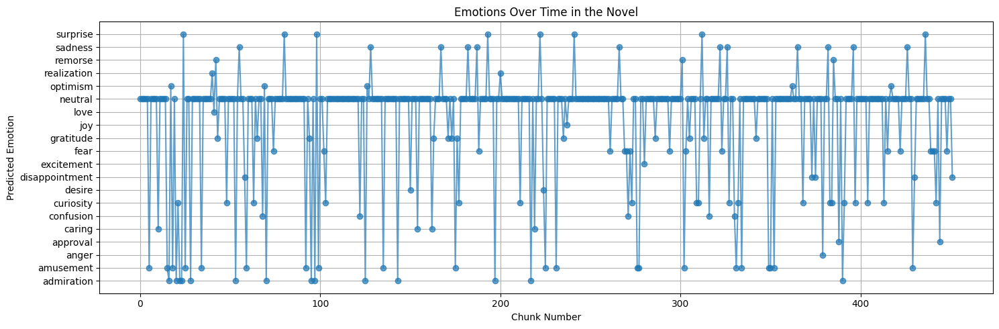

In [15]:
plot_emotions_over_time(df, emotion_column="Predicted_Emotion")

# Trying other model

In [ ]:
df_other_model = chunk_by_sentences(content, sentences_per_chunk=2)

In [19]:
from transformers import pipeline

# Load the emotion classification pipeline
classifier = pipeline(
    task="text-classification",
    model="SamLowe/roberta-base-go_emotions",
    top_k=None  # Return all possible emotion labels
)

# Load the CSV file
# df = pd.read_csv("/home/dorothee/code/magadare/emotionplot2/raw_data/emotion_sentimen_dataset.csv")
# df = df.head(250)

# Classify each phrase
phrases = df_other_model["chunk"].tolist()
results = classifier(phrases)

# Filter emotions with score above threshold
def filter_emotions(scores, threshold=0.5):
    return {s["label"]: round(s["score"], 3) for s in scores if s["score"] > threshold}

df_other_model["emotions"] = [filter_emotions(r, threshold=0.5) for r in results]

Device set to use cpu


In [38]:
df_other_model

,chunk,emotions
0,the adventures of sherlock holmes there is an ...,{'neutral': 0.958}
1,a case of identity iv. the boscombe valley mys...,{'neutral': 0.966}
2,the man with the twisted lip vii. the adventur...,{'neutral': 0.966}
3,the adventure of the speckled band ix. the adv...,{'neutral': 0.968}
4,the adventure of the beryl coronet xii. the ad...,{'neutral': 0.958}
...,...,...
2253,"then she got better at last, all worn to a sha...",{'neutral': 0.536}
2254,"fowler was a very kind spoken, free handed gen...",{}
2255,and here comes the country surgeon and mrs. ru...,{'neutral': 0.661}
2256,"they still live with their old servants, who p...",{'neutral': 0.928}


In [27]:
emotions_df = df_other_model["emotions"].apply(pd.Series).fillna(0)
emotions_df

,neutral,admiration,sadness,amusement,approval,curiosity,caring,optimism,surprise,disapproval,...,gratitude,desire,disappointment,confusion,joy,annoyance,fear,anger,excitement,nervousness
0,0.958,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.966,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.966,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.968,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.958,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2253,0.536,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2254,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2255,0.661,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2256,0.928,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0


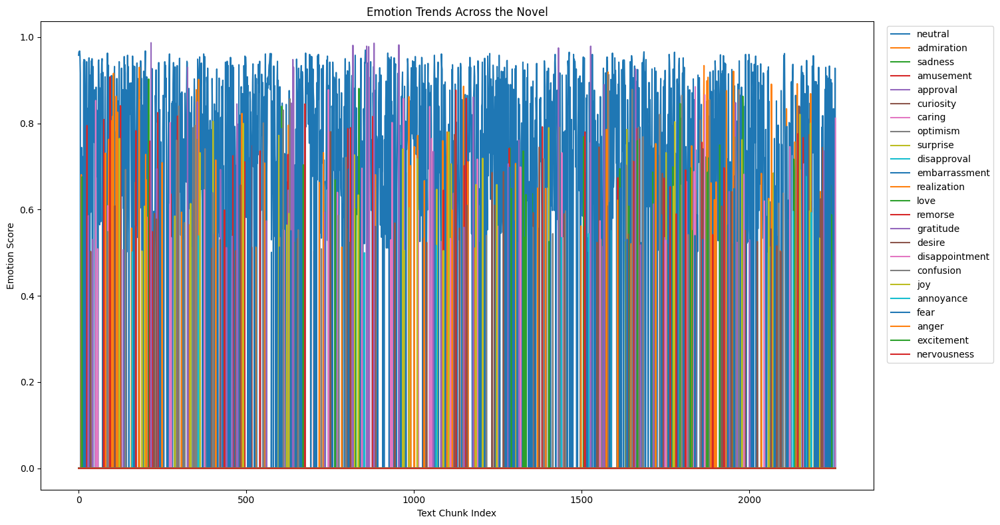

In [22]:
# Emotion trends over time

import matplotlib.pyplot as plt

emotions_df.reset_index(drop=True, inplace=True)

plt.figure(figsize=(15, 8))
for emotion in emotions_df.columns:
    plt.plot(emotions_df.index, emotions_df[emotion], label=emotion)

plt.title("Emotion Trends Across the Novel")
plt.xlabel("Text Chunk Index")
plt.ylabel("Emotion Score")
plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.tight_layout()
plt.show()

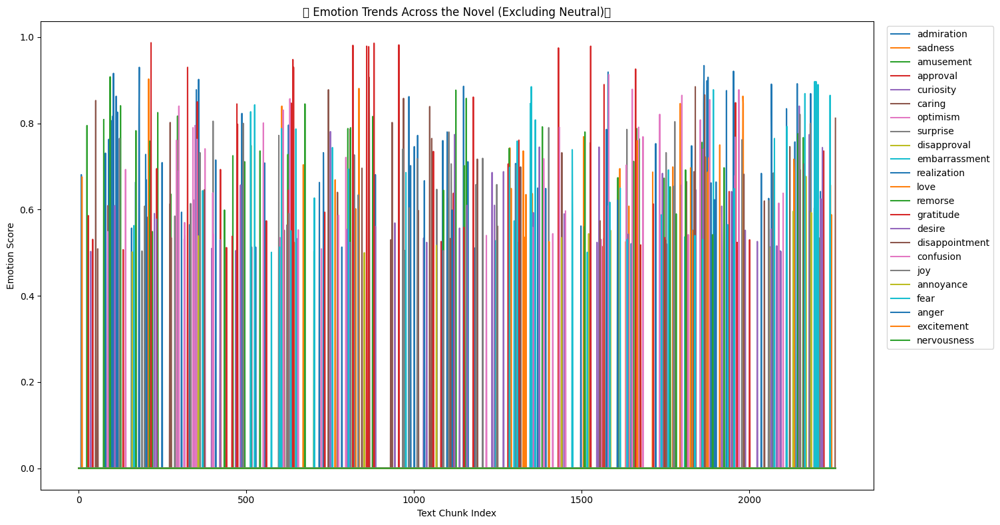

In [39]:
import matplotlib.pyplot as plt

emotions_df.reset_index(drop=True, inplace=True)

plt.figure(figsize=(15, 8))
for emotion in emotions_df.columns:
    if emotion != "neutral":
        plt.plot(emotions_df.index, emotions_df[emotion], label=emotion)

plt.title("📈 Emotion Trends Across the Novel (Excluding Neutral)📈")
plt.xlabel("Text Chunk Index")
plt.ylabel("Emotion Score")
plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
plt.tight_layout()
plt.show()


In [30]:
!pip install plotly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.3/16.3 MB 17.4 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2/2 [plotly]2m1/2 [plotly]


In [44]:
import plotly.graph_objects as go

fig = go.Figure()

# Add one trace per emotion (initially visible=False)
for i, emotion in enumerate(emotions_df.columns):
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion,
            visible=(emotion == "admiration")  # Show "admiration" by default
        )
    )

# Create dropdown buttons for each emotion
buttons = [
    dict(
        label=emotion,
        method="update",
        args=[{"visible": [e == emotion for e in emotions_df.columns]},
              {"title": f"Emotion Trend: {emotion}"}]
    )
    for emotion in emotions_df.columns if emotion != "neutral"
]

fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            x=1.15,
            y=1,
            showactive=True
        )
    ],
    title="Emotion Trend: admiration",
    xaxis_title="Text Chunk Index",
    yaxis_title="Emotion Score",
    width=1000,
    height=600
)

fig.show()

In [ ]:
import plotly.graph_objects as go

# Define wich emotions to plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

fig = go.Figure()

# Add a line for each emotion
for emotion in emotions_to_plot:
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion
        )
    )

# Customize layout
fig.update_layout(
    title="Emotion Trends Across the Novel",
    xaxis_title="Text Chunk Index",
    yaxis_title="Emotion Score",
    height=600,
    legend_title="Click emotions to show/hide:"
)

fig.show()


In [ ]:
import plotly.graph_objects as go

# Define wich emotions to plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

fig = go.Figure()

# Add a line for each emotion with custom hover text (chunk)
for emotion in emotions_to_plot:
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion,
            customdata=df_other_model["chunk"],  # Pass the chunk text
            hovertemplate=(
                "<b>Chunk Index:</b> %{x}<br>" +
                "<b>Emotion:</b> %{fullData.name}<br>" +
                "<b>Emotion Score:</b> %{y:.2f}<br>" +
                "<b>Text:</b> %{customdata}<extra></extra>"
            )
        )
    )

# Layout configuration
fig.update_layout(
    title="Emotion Trends Across the Novel",
    xaxis_title="Text Chunk Index",
    yaxis_title="Emotion Score",
    height=600,
    legend_title="Click to toggle emotions"
)

fig.show()


In [ ]:
import plotly.graph_objects as go

# Define wich emotions to plot
emotions_to_plot = [col for col in emotions_df.columns if col != "neutral"]

fig = go.Figure()

# Add a line for each emotion
for emotion in emotions_to_plot:
    fig.add_trace(
        go.Scatter(
            x=emotions_df.index,
            y=emotions_df[emotion],
            mode='lines',
            name=emotion,
            customdata=df_other_model["chunk"],  # Chunk text for hover
            hovertemplate=(
                "<b>Chunk Index:</b> %{x}<br>" +
                "<b>Emotion:</b> %{fullData.name}<br>" +
                "<b>Emotion Score:</b> %{y:.2f}<br>" +
                "<b>Text:</b> %{customdata}<extra></extra>"
            )
        )
    )

# Layout with zoom/pan enhancements
fig.update_layout(
    title="Emotion Trends Across the Novel",
    xaxis=dict(
        title="Text Chunk Index",
        rangeslider=dict(visible=True),  # Adds a scrollable slider below
        type="linear"
    ),
    yaxis=dict(
        title="Emotion Score"
    ),
    height=600,
    legend_title="Click to toggle emotions",
    dragmode="pan",  # Default drag mode
)

# Enables scroll zoom (wheel-based zooming) when using Jupyter or HTML export
fig.show(config={"scrollZoom": True})


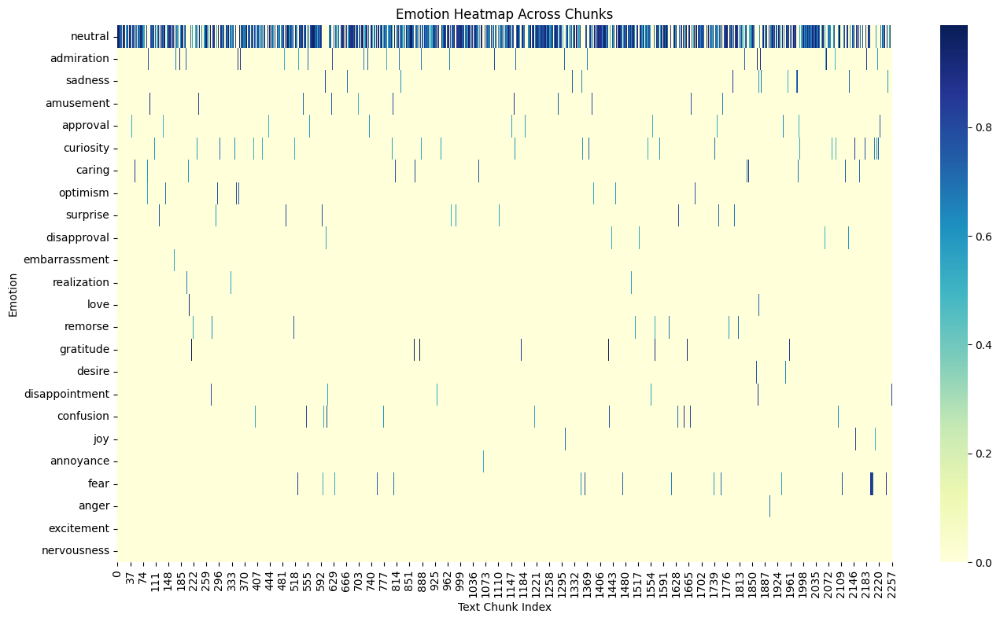

In [24]:
# Emotion intensity heatmap

import seaborn as sns

plt.figure(figsize=(14, 8))
sns.heatmap(emotions_df.T, cmap='YlGnBu', cbar=True)
plt.title("Emotion Heatmap Across Chunks")
plt.xlabel("Text Chunk Index")
plt.ylabel("Emotion")
plt.tight_layout()
plt.show()

<Axes: title={'center': 'Total Emotion Scores Across the Novel'}>

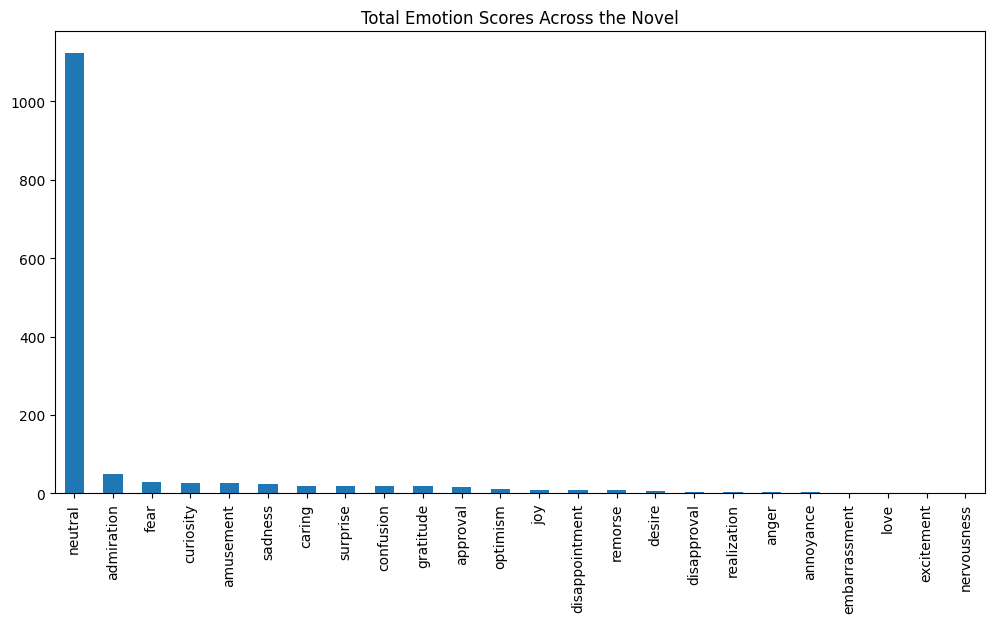

In [23]:
# Top emotions overall

emotions_df.sum().sort_values(ascending=False).plot(
    kind='bar', figsize=(12, 6), title='Total Emotion Scores Across the Novel'
)